# Notebook to run basic analysis on processed data after cellbender - FPR 0.07, full Model

**Created by :** Srivalli Kolla

**Created on :** 12 August, 2024

**Modified on :** 5 September, 2024

**Institute of SystemsImmunology, University of Würuburg**

Env : scanpy(Python 3.12.4)

# Importing packages

In [1]:
import anndata as ad
import scanpy as sc
import bbknn
import os
import datetime
import numba
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import median_abs_deviation

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

timestamp = datetime.datetime.now().strftime("%d_%m_%y")

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                 10.3.0
annoy               NA
asttokens           NA
attr                23.2.0
bbknn               1.6.0
cffi                1.16.0
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
defusedxml          0.7.1
distutils           3.12.4
django              5.0.6
executing           2.0.1
h5py                3.11.0
igraph              0.11.5
ipykernel           6.29.5
ipython_genutils    0.2.0
ipywidgets          8.1.3
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
louvain             0.8.2
matplotlib          3.8.4
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numexpr             2.10.1
numpy               1.26.4
packaging           24.1
pandas    

# Data importing and PreProcessing

In [3]:
ref = sc.read_h5ad('../../raw_data/raw_anndatas/dmd_merged_raw_before_cb_annotated_05_09_24.h5ad')
ref

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 213986 × 8000
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'cell_type-broad'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'cell_type-broad_colors', 'genotype_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [4]:
sample_dirs = ['A9_2', 'A10_2', 'A11_2', 'A12_2','B1_2', 'B2_2']
cellbender_data = '../../cellbender/0.07_full/'

cellbender_file_paths = [os.path.join(cellbender_data, sample, f"{sample}_filtered.h5") for sample in sample_dirs]

In [5]:
sample_to_genotype = {
    'A9_2': 'WT',
    'A10_2': 'WT',
    'A11_2': 'Mdx',
    'A12_2': 'Mdx',
    'B1_2': 'MdxSCID',
    'B2_2': 'MdxSCID'
}
processed_data = [sc.read_10x_h5(file_path) for file_path in cellbender_file_paths]

for after_cb in processed_data:
    after_cb.var_names_make_unique()

after_cb = ad.concat(processed_data, keys=sample_dirs, label='sample')
sample_names = [os.path.splitext(sample)[0] for sample in sample_dirs]  
after_cb.obs['genotype'] = after_cb.obs['sample'].map(sample_to_genotype)

after_cb

reading ../../cellbender/0.07_full/A9_2/A9_2_filtered.h5
 (0:00:00)
reading ../../cellbender/0.07_full/A10_2/A10_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:08)
reading ../../cellbender/0.07_full/A11_2/A11_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:09)
reading ../../cellbender/0.07_full/A12_2/A12_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:12)
reading ../../cellbender/0.07_full/B1_2/B1_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:20)
reading ../../cellbender/0.07_full/B2_2/B2_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:09)


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 188274 × 32285
    obs: 'sample', 'genotype'

In [6]:
after_cb.obs

,sample,genotype
CTTCAATCAATAGTCC-1,A9_2,WT
GATGCTAAGCAGTAAT-1,A9_2,WT
GCTACCTAGGTTGGTG-1,A9_2,WT
GATTCTTCACACCTTC-1,A9_2,WT
TAAGCCACATGAGAAT-1,A9_2,WT
...,...,...
CAGCAATAGAAGTCCG-1,B2_2,MdxSCID
TTGATGGGTTCCGCTT-1,B2_2,MdxSCID
CCTCCAATCCGATAAC-1,B2_2,MdxSCID
TCCTGCAGTTGTCCCT-1,B2_2,MdxSCID


In [7]:
after_cb.write_h5ad(f'../../cellbender/0.07_full/merged_cb_0.07_fpr_full_{timestamp}.h5ad')

In [8]:
after_cb  = sc.read_h5ad(f'../../cellbender/0.07_full/merged_cb_0.07_fpr_full_{timestamp}.h5ad') 
after_cb

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 188274 × 32285
    obs: 'sample', 'genotype'

In [9]:
after_cb.obs_names_make_unique()
after_cb

AnnData object with n_obs × n_vars = 188274 × 32285
    obs: 'sample', 'genotype'

## Quality check

In [10]:
def X_is_raw(after_cb):
    return np.array_equal(after_cb.X.sum(axis=0).astype(int), after_cb.X.sum(axis=0))

is_raw = X_is_raw(after_cb)
print(is_raw)

True


In [11]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

is_raw = X_is_raw(ref)
print(is_raw)

False


### Mt, Rb genes

In [12]:
after_cb.var["mt"] = after_cb.var_names.str.startswith("Mt-")

after_cb.var["ribo"] = after_cb.var_names.str.startswith(("Rps", "Rpl"))

In [13]:
sc.pp.calculate_qc_metrics(
    after_cb, qc_vars=["mt", "ribo"], inplace=True, percent_top=[20],log1p=True)
after_cb

AnnData object with n_obs × n_vars = 188274 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [14]:
def is_outlier(after_cb, metric: str, nmads: int):
    M = after_cb.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [15]:
after_cb.obs["outlier"] = (
    is_outlier(after_cb, "log1p_total_counts", 5)
    | is_outlier(after_cb, "log1p_n_genes_by_counts", 5)
    | is_outlier(after_cb, "pct_counts_in_top_20_genes", 5)
)
after_cb.obs.outlier.value_counts()

outlier
False    183438
True       4836
Name: count, dtype: int64

In [16]:
print(f"Total number of cells: {after_cb.n_obs}")
after_cb = after_cb[(~after_cb.obs.outlier)].copy()

print(f"Number of cells after filtering of low quality cells: {after_cb.n_obs}")

Total number of cells: 188274
Number of cells after filtering of low quality cells: 183438


### HVG

In [17]:
sc.pp.highly_variable_genes(after_cb,flavor = "seurat_v3",batch_key = "sample",subset = True, n_top_genes= 8000)
after_cb

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 183438 × 8000
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg'

### Normalization

In [18]:
sc.pp.normalize_total(after_cb, target_sum= 1e6)
sc.pp.log1p(after_cb)
after_cb.layers["normalized"] = after_cb.X.copy()

normalizing counts per cell
    finished (0:00:00)


### Principal Component Analysis

In [19]:
sc.pp.pca(after_cb, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(after_cb, use_rep = "X_pca", n_neighbors = 50, metric = 'minkowski', random_state = 1786)

computing PCA
    with n_comps=50


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:27)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:15)


### Batch correction

In [20]:
bbknn_donor = bbknn.bbknn(after_cb, 
    batch_key = "sample", copy = True)
bbknn_donor

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)


AnnData object with n_obs × n_vars = 183438 × 8000
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg', 'log1p', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'normalized'
    obsp: 'distances', 'connectivities'

## Label Transfer - Mapping Barcodes

In [21]:
ref.obs.index

Index(['AAACCCAAGACCCGCT-1', 'AAACCCAAGATAACAC-1', 'AAACCCAAGCGATGGT-1',
       'AAACCCAAGCTTTGTG-1', 'AAACCCAAGGAAAGTG-1', 'AAACCCAAGGAACGAA-1',
       'AAACCCAAGGCGACAT-1', 'AAACCCAAGTGGTTGG-1', 'AAACCCACAACAGCCC-1',
       'AAACCCACAACGAGGT-1',
       ...
       'TTTGTTGGTTGGAGGT-1', 'TTTGTTGTCACATACG-1', 'TTTGTTGTCACTACTT-1',
       'TTTGTTGTCCATATGG-1', 'TTTGTTGTCCCGTGTT-1', 'TTTGTTGTCCGAAATC-1',
       'TTTGTTGTCCGCTGTT-1', 'TTTGTTGTCGCGTGAC-1', 'TTTGTTGTCGGAGATG-1',
       'TTTGTTGTCGTGCATA-1'],
      dtype='object', length=213986)

In [22]:
bbknn_donor.obs.index

Index(['TCACACCAGATCCTAC-1', 'GATCAGTTCATGCATG-1', 'GTAGTACCAAGCAGGT-1',
       'TCTTGCGTCCGAACGC-1', 'GCTTGGGCACAAACGG-1', 'TCCACGTGTGGCCACT-1',
       'GGGAGTACATGTCAGT-1', 'ACATGCACACAACGCC-1', 'ATTCGTTAGACCAACG-1',
       'GCAACATAGACTCTAC-1',
       ...
       'TGAGGAGTCCTCGATC-1', 'TGCTGAACAGCCTATA-1', 'TAGAGTCAGCATGTTC-1',
       'GTCAGCGGTGACAGCA-1', 'TAGAGTCCAGATACTC-1', 'TCCTTCTTCTTTCTTC-1-1',
       'ACCGTTCTCTACTATC-1', 'TTCTCTCTCCCTCTCT-1-1', 'CTGTATTAGGGCCTCT-1',
       'CTATAGGTCATCACTC-1'],
      dtype='object', length=183438)

In [23]:
ref_barcodes = pd.DataFrame(ref.obs.index, columns= ['barcodes'])
ref_barcodes

,barcodes
0,AAACCCAAGACCCGCT-1
1,AAACCCAAGATAACAC-1
2,AAACCCAAGCGATGGT-1
3,AAACCCAAGCTTTGTG-1
4,AAACCCAAGGAAAGTG-1
...,...
213981,TTTGTTGTCCGAAATC-1
213982,TTTGTTGTCCGCTGTT-1
213983,TTTGTTGTCGCGTGAC-1
213984,TTTGTTGTCGGAGATG-1


In [24]:
ref_barcodes['cell_type-broad'] = ref.obs['cell_type-broad'].values
ref_barcodes

,barcodes,cell_type-broad
0,AAACCCAAGACCCGCT-1,cardiomyocytes
1,AAACCCAAGATAACAC-1,lymphoid
2,AAACCCAAGCGATGGT-1,lymphoid
3,AAACCCAAGCTTTGTG-1,lymphoid
4,AAACCCAAGGAAAGTG-1,lymphoid
...,...,...
213981,TTTGTTGTCCGAAATC-1,lymphoid
213982,TTTGTTGTCCGCTGTT-1,vascular states
213983,TTTGTTGTCGCGTGAC-1,lymphoid
213984,TTTGTTGTCGGAGATG-1,lymphoid


In [25]:
bbknn_donor_barcodes = pd.DataFrame(after_cb.obs.index, columns= ['barcodes'])
bbknn_donor_barcodes

,barcodes
0,TCACACCAGATCCTAC-1
1,GATCAGTTCATGCATG-1
2,GTAGTACCAAGCAGGT-1
3,TCTTGCGTCCGAACGC-1
4,GCTTGGGCACAAACGG-1
...,...
183433,TCCTTCTTCTTTCTTC-1-1
183434,ACCGTTCTCTACTATC-1
183435,TTCTCTCTCCCTCTCT-1-1
183436,CTGTATTAGGGCCTCT-1


In [26]:
mapping_dict = ref_barcodes.set_index('barcodes')['cell_type-broad'].to_dict()
mapping_dict

{'AAACCCAAGACCCGCT-1': 'cardiomyocytes',
 'AAACCCAAGATAACAC-1': 'lymphoid',
 'AAACCCAAGCGATGGT-1': 'lymphoid',
 'AAACCCAAGCTTTGTG-1': 'lymphoid',
 'AAACCCAAGGAAAGTG-1': 'lymphoid',
 'AAACCCAAGGAACGAA-1': 'lymphoid',
 'AAACCCAAGGCGACAT-1': 'vascular states',
 'AAACCCAAGTGGTTGG-1': 'cardiomyocytes',
 'AAACCCACAACAGCCC-1': 'myeloid',
 'AAACCCACAACGAGGT-1': 'vascular states',
 'AAACCCACAATACCCA-1': 'lymphoid',
 'AAACCCACACCAATTG-1': 'lymphoid',
 'AAACCCACAGACCAAG-1': 'lymphoid',
 'AAACCCACATTGCCTC-1': 'vascular states',
 'AAACCCAGTACCTAAC-1': 'lymphoid',
 'AAACCCAGTACTCCGG-1': 'myeloid',
 'AAACCCAGTCACATTG-1': 'fibroblasts',
 'AAACCCAGTCCACGCA-1': 'lymphoid',
 'AAACCCAGTGACTGTT-1': 'cardiomyocytes',
 'AAACCCAGTGCAGGAT-1': 'vascular states',
 'AAACCCAGTGCATGTT-1': 'lymphoid',
 'AAACCCAGTTACACAC-1': 'lymphoid',
 'AAACCCATCATCTACT-1': 'fibroblasts',
 'AAACCCATCATTCCTA-1': 'lymphoid',
 'AAACCCATCCAACACA-1': 'lymphoid',
 'AAACCCATCCAACTGA-1': 'vascular states',
 'AAACCCATCCGATGTA-1': 'lymphoid'

In [27]:
bbknn_donor_barcodes['cell_type-broad'] = bbknn_donor_barcodes['barcodes'].map(mapping_dict).fillna('Unmatched')

bbknn_donor.obs['cell_type-broad'] = bbknn_donor_barcodes['cell_type-broad'].values

bbknn_donor.obs['cell_type-broad'].value_counts()

cell_type-broad
Unmatched          88984
lymphoid           53081
vascular states    19945
fibroblasts         8297
myeloid             6824
cardiomyocytes      6307
Name: count, dtype: int64

# Data visualization

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:37)


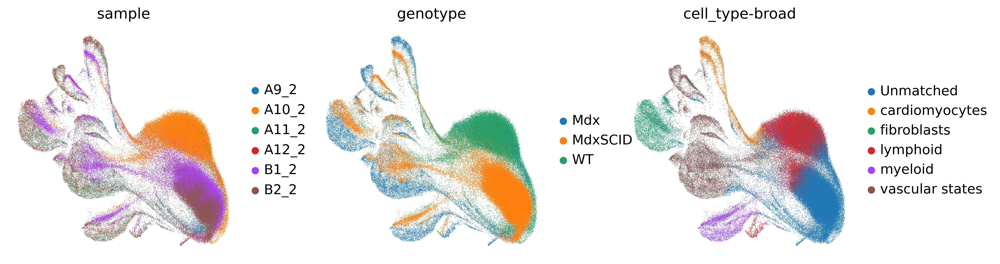

In [28]:
sc.tl.umap(bbknn_donor)
sc.pl.umap(bbknn_donor, color= ['sample','genotype','cell_type-broad'], frameon =False)

In [29]:
genes_of_interest = ['Il2','Tnnt2','Il10', 'Ttn','Dcn','Myh7', 'Dmd','Ctnna3','Lama2','Ryr2','Cd19','Cd3e','Cd44', 'Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Nrxn1', 'Adipoq', 'Trem2']

present_genes = [gene for gene in genes_of_interest if gene in bbknn_donor.var.index]

In [30]:
sc.pl.umap(bbknn_donor, color = present_genes, frameon = False)

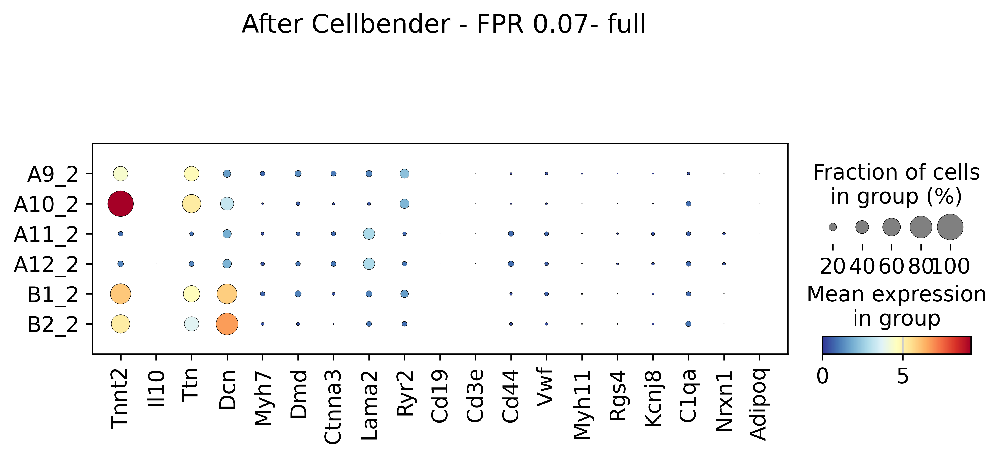

In [31]:
sc.pl.dotplot(bbknn_donor, var_names= present_genes, groupby= 'sample', cmap= 'RdYlBu_r', title= ' After Cellbender - FPR 0.07- full')

## LogFC changer per Gene

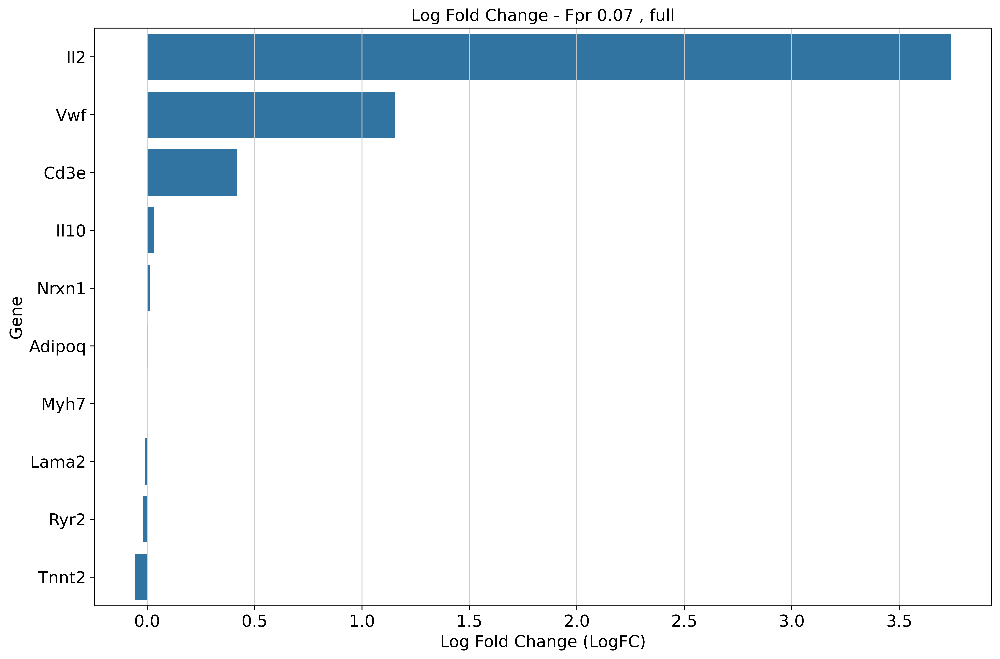

In [35]:
ref_log_expr = ref.X
cb_log_expr = bbknn_donor.X

ref_mean_log_expr = np.mean(ref_log_expr,axis=0)
cb_mean_log_expr = np.mean(cb_log_expr,axis=0)

log_fc = cb_mean_log_expr - ref_mean_log_expr
log_fc.shape

log_fc = np.asarray(log_fc)
log_fc = log_fc.flatten()
log_fc.shape

log_fc_df = pd.DataFrame({'Gene': ref.var_names, 'LogFC': log_fc})
log_fc_df


filtered_df = log_fc_df[log_fc_df['Gene'].isin(genes_of_interest)]
filtered_df = filtered_df.sort_values(by='LogFC', ascending=False)

plt.figure(figsize=(12, 8)) 
sns.barplot(x='LogFC', y='Gene', data=filtered_df)
plt.xlabel('Log Fold Change (LogFC)')
plt.ylabel('Gene')
plt.title('Log Fold Change - Fpr 0.07 , full')
plt.tight_layout()
plt.show()

## Mean expression of gene per celltype

/tmp/ipykernel_1572844/2209402730.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expression_per_cell_type = gene_expression_df.groupby('cell_type-broad').mean().reset_index()


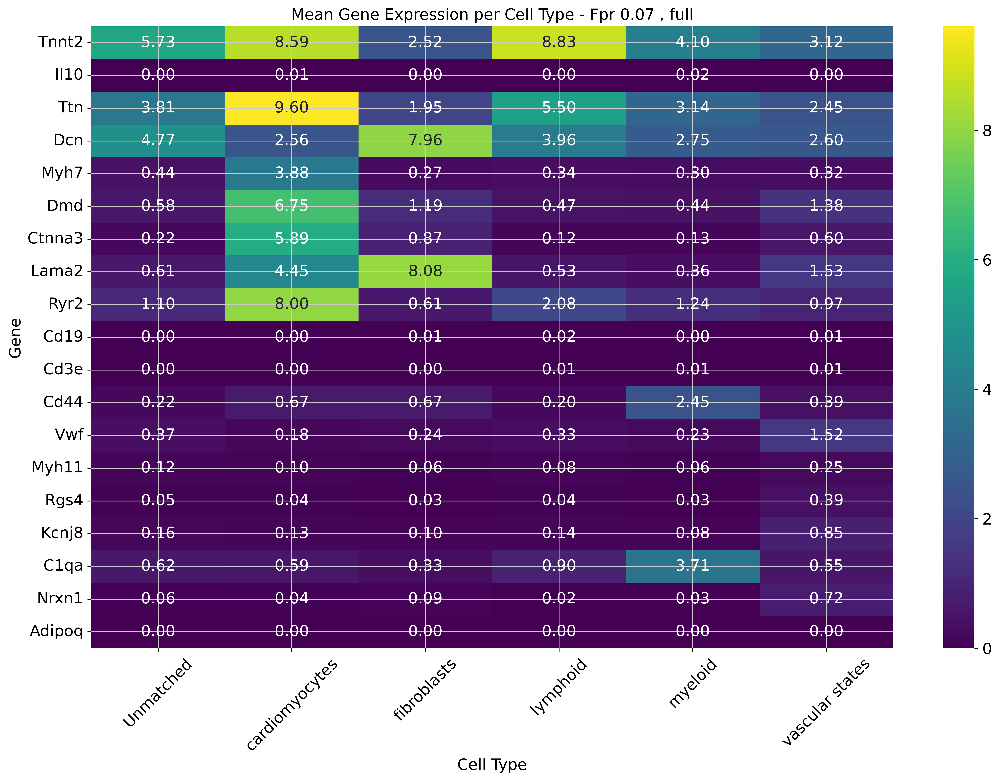

In [33]:
gene_expression_data = bbknn_donor[:, present_genes].X
if hasattr(gene_expression_data, 'toarray'):
    gene_expression_data = gene_expression_data.toarray()

gene_expression_df = pd.DataFrame(gene_expression_data, columns=present_genes)
gene_expression_df['cell_type-broad'] = bbknn_donor.obs['cell_type-broad'].values

mean_expression_per_cell_type = gene_expression_df.groupby('cell_type-broad').mean().reset_index()

mean_expression_long = mean_expression_per_cell_type.melt(id_vars='cell_type-broad', var_name='Gene', value_name='Mean Expression')

plt.figure(figsize=(14, 10))
sns.heatmap(mean_expression_per_cell_type.set_index('cell_type-broad').T, cmap='viridis', annot=True, fmt='.2f')
plt.title('Mean Gene Expression per Cell Type - Fpr 0.07 , full')
plt.xlabel('Cell Type')
plt.ylabel('Gene')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## LogFc per celltype

/tmp/ipykernel_1572844/1609553630.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ref_mean_expression = ref_expr_df.groupby(ref.obs['cell_type-broad']).mean()
/tmp/ipykernel_1572844/1609553630.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bbknn_mean_expression = bbknn_expr_df.groupby(bbknn_donor.obs['cell_type-broad']).mean()
/tmp/ipykernel_1572844/1609553630.py:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragment

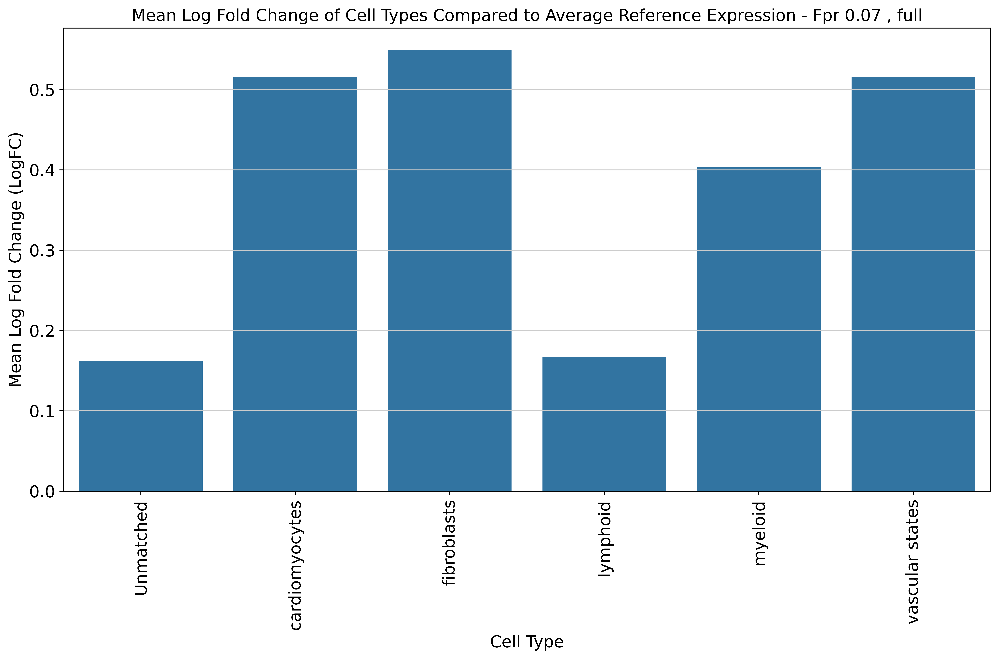

In [34]:
ref_expr_df = ref.to_df()
bbknn_expr_df = bbknn_donor.to_df()

ref_mean_expression = ref_expr_df.groupby(ref.obs['cell_type-broad']).mean()
bbknn_mean_expression = bbknn_expr_df.groupby(bbknn_donor.obs['cell_type-broad']).mean()

common_genes = ref_mean_expression.columns.intersection(bbknn_mean_expression.columns)
ref_mean_expression = ref_mean_expression[common_genes]
bbknn_mean_expression = bbknn_mean_expression[common_genes]


mean_ref_expression = ref_mean_expression.mean(axis=0)

log_fc_df = pd.DataFrame(index=bbknn_mean_expression.index, columns=common_genes)

for gene in common_genes:
    ref_expr = mean_ref_expression[gene]
    log_fc_df[gene] = np.log2((bbknn_mean_expression[gene] + 1) / (ref_expr + 1))  # Adding 1 to avoid log of zero

log_fc_df['Mean LogFC'] = log_fc_df.mean(axis=1)

log_fc_df.reset_index(inplace=True)
log_fc_df.rename(columns={'index': 'cell_type'}, inplace=True)

plt.figure(figsize=(12, 8))
sns.barplot(x='cell_type-broad', y='Mean LogFC', data=log_fc_df)
plt.xticks(rotation=90)
plt.title('Mean Log Fold Change of Cell Types Compared to Average Reference Expression - Fpr 0.07 , full')
plt.xlabel('Cell Type')
plt.ylabel('Mean Log Fold Change (LogFC)')
plt.tight_layout()
plt.show()
